# CV

Below I'll present different areas of **Image Recognition**

- **Image / object classification**: assigning a label to an entire image based on its content. Use e.g. CNN. 
    - You send an image and receive one output corresponding to the class of the image.
- **Object detection / localisation**: identifies multiple objects in an image / video and places bounding boxes around them. 
  - Bounding box - rectangles defined by two opposite points, these are widely used for object detection and localization tasks, providing a straightforward way to describe the position and size of objects in an image.
  - *Static Detection* - detect objects in images; *Video / Real-Time Object Detection* - detect objects in a (real-time) video. 
  - Gives us *bounding box* of an identified object (with x, y, width, and height) and *class* (e.g. car).
  - Uses Deep Learning algorithms: CNN (convolutional NN), RCNN (regions with CNN), Fast-RCNN and Faster-RCNN, YOLO. 
- **Semantic segmentation (image / object)**: gives an exact shape of the detected objects by classifying each pixel of an image to the corresponding class. 
- **Instance segmentation**: makes two segments (e.g. poeple) and then differentiate between them. 

---

**Optical character recognition**: recognising text within images and converting it into machine-readable text.

- Others: image restoration, 3D reconstruction, video analysis. 
- Packages: `cv2` (`pip install opencv-python`)

<img src="Media/cv.png" width="500px">

Datasets for Image Classification:
| Dataset | Description |
| - | - |
| MNIST | 70,000 28*28 pixel black-and-white (grayscale) images of handwritten digits that are labelled 0 to 1. http://yann.lecun.com/exdb/mnist/ |
| CIFAR-10 | 60,000 32*32 pixel colored images with 10 different labels (airplanes, cars, birds, cats, deer, dogs, frogs, horses, ships, and trucks). The database is maintained by the Canadian Institute for Advanced Research. https://www.cs.toronto.edu/~kriz/cifar.html |
| CIFAR-100 | similar to CIFAR-10 but with 100 labels |
| ImageNet | it is a large-scale image database containing a vast amount of controlled and human-annotated images |

For image detection and segmentation, error functions:
| Metric | Description | Equation |
| - | - | - |
| IoU (intersection over union) | How good is the location? How close the predicted bounding box is to the ground truth. Really, it's just overlap of two sets. | $$IoU = \cfrac{\text{area of intersection}}{\text{area of union}}$$ $$IoU = \cfrac{A\cap B}{A\cup B}$$ |
| Average precision | How accurate is classification for one class. | It is calculated by finding the area under the PR curve. |
| Mean average precision (mAP) | How accurate is classification across multiple classes. mAP = average precision metric across all classes in a model. mAP can be for a single value threshold of IoU, e.g. where IoU = 0.5 (mAP@0.5) or a range, such as $IoU \in [0.5, 0.95]$, (mAP@0.5:0.95). Good mAP indicates that's stable and consistent across different confidence thresholds. Therefore, mAP could be used on the validation set to select the model that is the most stable and consistent (has the highest mAP). | mAP is the average of AP for each class. $$mAP \in [0,1]$$ |
| Dice Similarity Coefficient (DSC) | In here, in the denominator, we count the intersection twice.  | $$DSC = \cfrac{2 \| A \cap B \|}{\|A\| + \|B\|}$$, where $\|A\|$ - count of items in a set |

---

```py
### We can capture video from different sources:
cap = cv2.VideoCapture('video3_dance.mp4') # locally-saved video
cap = cv2.VideoCapture(0) # webcam

### Two ways to pass arguments
cv2.circle(img, (cx, cy), 25, (255,0,255), cv2.FILLED)
cv2.circle(img=img, center=(cx,cy), radius=25, color=(0,0,255), thickness=cv2.FILLED)

# Initialize the video camera
cap = cv2.VideoCapture(0)
# OPTIONAL: set video window dimensions
wCam, hCam = 300, 300
cap.set(3, wCam)
cap.set(4, hCam)



```




# Pre-trained models

> transfer learning


Transfer learning:
- ResNet
- ImageNet (https://image-net.org)

# Algorithms

Algorithms in CV:
| Algorithm | Short description | Advantages | Disadvantages |
| - | - | - | - |
| DPM <br><br>(Deformable Parts Model) | Uses a sliding window approach to object detection. | | |
| U-Net | | Used for image segmentation. Excellent accuracy for (medical) image segmentation tasks. Requires very few images for training. Can effectively capture both local and global features in the input image. | <ul><li>Can be computationally heavy.</li></ul>  |
| R-CNN <br><br>(region-based CNN) | R-CNN and its variants use region proposals instead of sliding window to find objects in images. | | <ul><li>It is very slow due to the selective search algorithm.</li><li>It's a multi-stage process, therefore, it cannot be trained end-to-end.</li><li>Is heavy on memory: It caches the extracted features from the pre-trained CNN on the disk to later train the SVMs</li><li>Cannot be used for real-time detection</li></ul> |
| Fast R-CNN | Object detection. | | <ul><li>Cannot be used for real-time detection</li></ul> |
| Faster R-CNN | Object detection. | <ul><li>Can be used for real-time detection.</li></ul> |  |
| Mask R-CNN | | Object detection and segmentation. | <ul><li>Slower.</li></ul> |
| YOLO <br><br>(You Only Look Once) | A fast, real-time algorithm used for object detection that processes the entire image only once with a single CNN. <br> Applications include real-time organ detection in CT scan, security surveillance, self-driving cars. | <ul><li>Speed: can work real-time</li><li>Performance: has excellent mAP; is less likely to predict false positives on background</li><li>Better generalisation: can be trained on natural images and then applied to artwork.</li><li>open source</li><li>Can detect multiple objects</li></ul> | <ul><li>The model struggles with small objects that appear in groups, such as flocks of birds.</li><li>Makes more localization errors, esp. of small objects: loss functions treats errors the same in small and large bboxes, therefore, a small error in a large box is generally benign but a small error in a small bbox has a much greater effect on IoU.</li> |


Current detection systems repurpose classifiers to perform 
detection. To detect an object, these systems take a
classifier for that object and evaluate it at various locations
and scales in a test image. Systems like deformable parts
models (DPM) use a sliding window approach where the
classifier is run at evenly spaced locations over the entire
image [10].

Algorithm can use sliding window and classification, region proposal-based techniques, or like YOLO.

## CNN

CNN advantages:
- Location invariant: detect patterns in any place of the image
- Takes into account the spatial structure of the training data

A number of advanced deep learning models based on CNN can be used in the field:
- AlexNet
- Xception
- Inception
- Visual Geometry Group (VGG)
- ResNet

<u>Overview of the architecture</u>:

CNN consists of three main layers:
1. **Convolutional layer**: this layer uses filters and kernels to help abstract the input image as a feature map as per each filter
2. **Pooling layer**: this layer downsamples feature maps by summarising the presence of features in different areas / patches of the feature map;
3. **Fully connected layer**: fully connected layers connect every neuron in one layer to every neuron in another layer. 

> More information: https://viso.ai/deep-learning/mask-r-cnn/
>
> https://www.youtube.com/watch?v=zfiSAzpy9NM

<u>Overview of the algorithm</u>:
- Divide the image into grids;
- Get filters for specific features of the image to be detected (e.g. for digit nine, the filters could be imagined as one for the loop, one for the vertical line, and one for the diagonal line);
- For each filter, construct feature map which shows presence of filter in different grids of the image; high number for a grid cell means detected presence of a feature from the filter for this area;
- For each feature map, apply activation function
- As we get feature maps for each filter, we apply yet another filter, this time for spatial location of the features from the feature maps relative to one another; 
- Repeat previous two steps for each level of feature maps

<u>A more detailed view of the algorithm</u>:

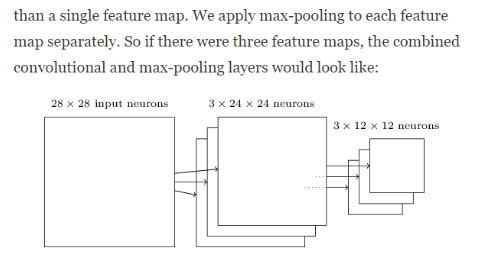

**Step 1: convolution**

- Instead of every layer being completely connected, connections are made in small, localised regions of the input image (local receptive field); it's like a little window on the input pixels;
- For each local receptive field, there is a different hidden neuron in the first hidden layer; 
- The same weights and biases are used for each neuron in the first hidden layer, which means that they will detect the same pattern for this filter. Therefore, we can call the map from input layer to the hidden layer a feature map. This feature map is defined by shared weights and biases, which are also called a filter (kernel);
- Normally, convolutional layer consists of multiple feature maps (filters);

> Note: when starting with an image that is $a*x$ pixels, after having run an initial convolutional layer, we lose pixels. E.g. running an initial convolutional layer that has 3*3 filters we will obtain a $(a-2)*(b-2)$ pixel output. Running it through a 5-by-5 filter will produce a (a-4)*(b-4) pixels in shape.

Some illustrative images for improving the understanding / intuition: 

| | |
| - | - |
| 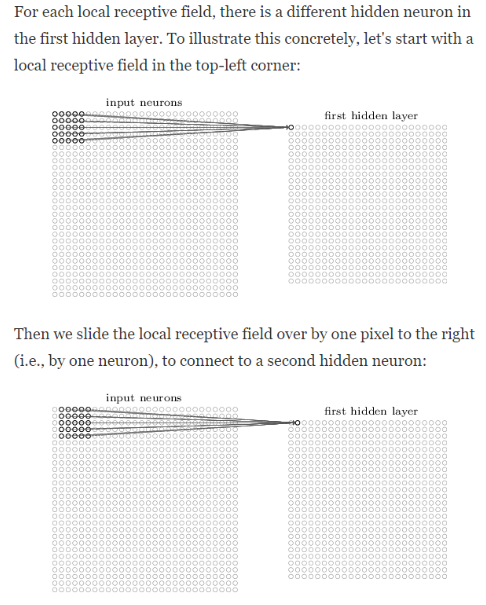 | 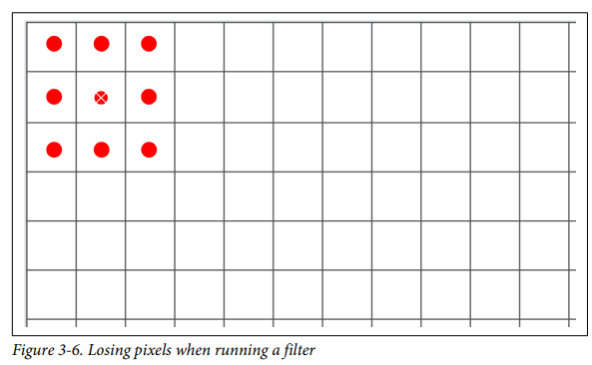 |
| <img src="Media/CNN.gif" width=600> | |

**Step 2: pooling**

- **Pooling layer**: usually used immediately after convolutional layers. They simplify the information in the output from convolutional layer. 
- **Max-pooling**: a pooling unit simply outputs the maximum activation in the e.g 2*2 input region. From small defined regions from convolutional layer, gets the maximum value and therefore outputs a condensed map. we apply max-pooling to each feature map separately. 
- In a way, max-pooling answers: is a feature found anywhere in a rough region in the image, without specifying the specific pixel but specifying the roughly region? 
- **L2 pooling**: instead of taking the maximum activation of a 2×2 region of neurons, we take the square root of the sum of the squares of the activations in the 2×2 region. 

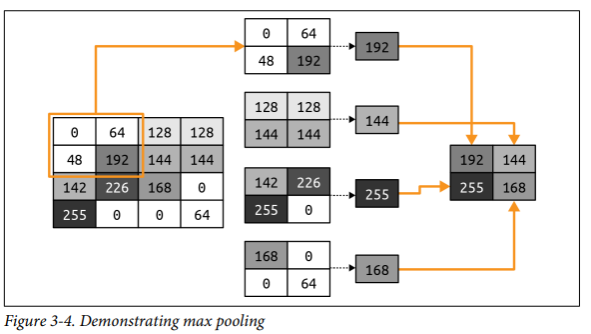

> A pooling layer with window size = (2,2) will halve each dimension, so image entering 26*26 becomes 13*13. 


## U-Net

Contains only convolutional layers (no dense layers). U-shaped encoder-decoder architecture. First, in Encoding, at each level we condense information (size of input halves, but number of channels doubles at each level) by convolution, then go down the level by max pooling. Decoder. <img src="Media/unet.png" width=700>

## R-CNN

Region-based CNN.

The basic idea behind R-CNN is to first generate a set of region proposals in an image, and then classify each region proposal as either containing an object or not.

<img src="Media/r-cnn.png" width="700px">
<img src="Media/r-cnn2.png" width="600px">

**R-CNN algorithm**:
- *Generate region proposals* using algorithms such as Selective Search, Edge Boxes. 
    - Selective Search: region proposal algorithm that groups regions together based on their pixel intensities. It locates the similar colours in the regions and merges them together, thus grouping regions together based on their pixel intensities. 
- *Warping (resizing)*: the proposal regions are cropped out of the image and resized;
- *CNN for object extraction*: resized regions are passed through CNN, which extracts a set of features from the region;
- *SVM classification*: the extracted features are fed to SVM classifier, which then classifies the objects presented under a region of interest AND predicts four values which are offset values to increase the precision of the bbox. 

The problems:
- Training is a multi-stage pipeline: CNN, SVM, and bbox regressors are all pre-trained for classification. 

## Fast R-CNN

<img src="Media/fast-r-cnn.png">

Features:
- Similar to R-CNN; 
- Fast R-CNN is faster than R-CNN, as it shares computations across multiple proposals;
- Improving upon R-CNN, it eliminates the need for warping regions, region-specific CNN operations, and CNN-feature caching. No more class-specific SVMs;
- Unlike the R-CNN, Fast R-CNN detector processes the entire image.

Algorithm:
- Input image is fed to CNN, generating a convolutional feature map. 
- From that map, we identify the region of proposals (using region proposal algorithm, normally selective search), warp them into squares;
- RoI pooling layer is used to extract a fixed-length feature vector for each proposed region.
    - The idea of RoI (Region of Interest) pooling is similar to the spatial pyramid pooling from SPPnets that pools CNN features from selected regions into a fixed-length feature vector for further enrichment.
- Each feature vector is passed through fully-connected layers (FC) for further enrichment;
- Subsequently, softmax layer (classification branch) produces probability of each ROI belonging to each label, and the bbox regressor estimates four values for the bboxes of the detected objects. 

https://kikaben.com/fast-r-cnn-213/



## Faster R-CNN

Features:
- As opposed to the previous iterations, here the region proposals are generated by RPN (Region Proposal Network), which could be trained and customised; It doesn't use selective search algorithm; instead, it lets the network learn the region proposals. 
- Faster R-CNN is a two-stage object detection algorithm that is composed of two parts: 1) RPN (deep CNN) and 2) Fast R-CNN detector; 

<img src="Media/faster-r-cnn.png" width="400px">

Algorithm:

- RPN: input image goes through CNN to generate convolutional feature map and then region proposals;
    - Region proposals are generated by sliding a small network over the convolutional feature map output by the last shared convolutional layer. 
- For all regions proposals in the image, a fixed-length feature vector is extracted from each region using the ROI Pooling layer;
- The extracted feature vectors are classified using Fast R-CNN;
- Return class scores of the detected objects and bboxes;


## Mask R-CNN

Mask R-CNN is an extension of Faster R-CNN that also includes a mask prediction branch to generate instance-level segmentation masks for each detected object in the image.


## YOLO

**Features**:
- Makes predictions of bbox and class probabilities at once;
- Algorithm architecture is a simple deep CNN;
- Frames object detection as a regression problem to spatially separated bounding boxes and associated class probabilities
- YOLO sees the entire image during training and test time so it implicitly encodes contextual information about classes as well as their appearance

**Algorithm architecture**:

Overall:
- 24 conv layers;
- 4 max-pooling layers;
- 2 fully-connected layers;

<img src="Media/yolo_architecture.png" width=800>

**Algorithm**

<u> Step 1</u>: 

Divide an image into $S*S$ grid consisting of square cells;

<u>Step 2</u>: 

Each grid cell predicts $B$ bboxes and confidence score for those bboxes. Confidence is defined as $Pr(Object) * IOU(\cfrac{truth}{pred})$, being equal to zero if no object is detected for a cell. 

bbox regression: YOLO determines the attributes of bboxes using regression module in this format ($Y$ - final vector representation of each bbox): 
$$Y = [pc, bx, by, bh, bw, c1, c2]$$
, $pc$ - probability score of grid containing an object; $bx, by \in [0,1]$, $x$ and $y$ coordinates of center of bbox; $bh, bw$ - height and width of bbox; $c1, c2 \in {0,1}$ - belonging to a class (one-hot encoded).  

So, for each cell in the grid, we generate one or more $Y$-vector.

Generally, predictions are encoded as an $S*S*(B*5 + C)$ tensor.

<u>Step 3</u>: 

YOLO assigns one bbox to be responsible for predicting objects (in one cell) based on which prediction has the highest IoU with the ground truth. 

So IoU (between actual bbox and the predicted bbox) decides which bbox gives us a good prediction, e.g. based on an arbitrary threshold of 0.5. 

So if IoU > 0.5, we say prediction is good enough. 

<u>Step 4</u>: 

NMS - non-max suppression - is used to remove redundant / incorrect bboxes (and output 1 bbox) for each object in the image, leaving only one correct for that object.

Algorithm for NMS:
1. Discard all bboxes with p < pre-defined p_threshold (e.g. 0.5)
2. For the remaining bboxes, :
    1. Pick bbox with the highest probability and take that as output prediction.
    2. Discard any other bbox which has IoU > IoU_threshold with the output prediction from the previous step. 
3. Repeat step 2 until all boxes are either taken as output prediction or discarded. 


<img src="Media/YOLO.png" width=500> 

### Commands

```py
### The first step is to clone the YOLOv5 repo from Github
!git clone https://github.com/ultralytics/yolov5
%cd yolov5
%pip install -qr requirements.txt
%pip install -q roboflow

### (optional) Download dataset from Roboflow, already annotated. 
os.environ["DATASET_DIRECTORY"] = "/content/datasets" # indicate where this dataset will be downloaded
from roboflow import Roboflow
rf = Roboflow(api_key="<api_key_here>")
project = rf.workspace("joseph-nelson").project("bccd")
dataset = project.version(4).download("yolov5")
```

Check that you YAML file looks like this:
```txt
train: ../dataDir/images/train
val: ../dataDir/images/train
### OPTIONAL: test directory
test: ../dataDir/images/test

# number of classes
nc: 2

# class names
names: ['person', 'pig]
```

```py
### (OPTIONAL) evolution for checking the best hyperparameters
!python train.py --img 416 --batch 16 --epochs 1 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache --evolve 10
### so if you choose evolution, you can choose hyperparameter obtained from evolve for the actual training
!python train.py --img 416 --batch 16 --epochs 10 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache --hyp runs/evolve/exp/hyp_evolve.yaml

### Train on custom data (no evolution)
### For better performance, you can reduce -batch to 1 and remove --cache
!python train.py --img 416 --batch 16 --epochs 5 --data c:/Users/evgen/Desktop/DatasetName/data.yaml --weights yolov5n.pt --cache

### Get test value for the test set
!python val.py --task test --weights runs/train/exp/weights/best.pt --img 416 --data {dataset.location}/data.yaml

### DETECT
### 1. From images folder, saving each into output folder
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source {dataset.location}/test/images
### These will usually be saved (inside of YOLOv5 directory) to runs/detect/exp
### 2. From a video, save detection video with saving txt file with bbox coordinates for each frame
!python detect.py --weights runs/train/name/weights/best.pt --source "c:/Users/UserNameHere/Desktop/Video1.mp4" --save-txt
### 3. from web cam
!python detect.py --weights runs/train/exp8/weights/best.pt --source 0

```

## Mobilenetv2

Mobilenetv2 is a lightweight multiclass CNN. Has 3.4 million parameters, input image size: 224*224 pixels. 

In [17]:
from tensorflow.keras.applications.mobilenet_v2 import MobileNetV2, preprocess_input, decode_predictions
from tensorflow.keras.preprocessing import image 
import tensorflow as tf
import numpy as np

model = MobileNetV2(weights='imagenet')

In [18]:
img = image.load_img(
    'Media/german-shepherd.jpg',
    target_size=(224, 224)
)
img_array = image.img_to_array(img)
img_array.shape

(224, 224, 3)

In [19]:
img_array = np.expand_dims(img_array, axis=0)
img_array.shape

(1, 224, 224, 3)

In [20]:
img_array = preprocess_input(img_array)


In [21]:
img_array.shape

(1, 224, 224, 3)

In [22]:
predictions = model.predict(img_array)
predictions

1/1 [==============================] - 1s 917ms/step


array([[8.47837073e-05, 6.13401062e-05, 3.18247985e-05, 4.10877328e-05,
        1.57622944e-05, 2.53080325e-05, 2.10820472e-05, 3.75773270e-05,
        5.60947519e-05, 6.17144615e-05, 2.54261849e-05, 4.72769389e-05,
        7.28340165e-05, 5.25629839e-05, 5.59731270e-05, 1.82586555e-05,
        2.70383789e-05, 4.44699217e-05, 5.49889555e-05, 4.12398913e-05,
        3.84469204e-05, 8.37405096e-05, 1.67079943e-05, 2.06634013e-05,
        6.67822751e-05, 7.61564152e-05, 3.97970507e-05, 2.95566406e-05,
        2.71487606e-05, 3.17971644e-05, 3.20299296e-05, 2.88917690e-05,
        3.87644650e-05, 7.22435798e-05, 4.82471514e-05, 2.94663532e-05,
        3.10559626e-05, 2.87187013e-05, 2.31753456e-05, 3.29851100e-05,
        5.81665481e-05, 3.73141411e-05, 3.47483401e-05, 4.74923108e-05,
        4.10144457e-05, 4.14274473e-05, 3.58546204e-05, 5.24851930e-05,
        2.94432357e-05, 8.42837253e-05, 3.25194669e-05, 2.59972476e-05,
        5.84905174e-05, 4.04730308e-05, 2.77271847e-05, 5.478403

In [23]:
decoded_predictions = decode_predictions(predictions, top=3)[0]
decoded_predictions

[('n02106662', 'German_shepherd', 0.91990083),
 ('n02105162', 'malinois', 0.0095704235),
 ('n04254680', 'soccer_ball', 0.0026964492)]

# Libraries

## OpenCV

```powershell
pip install opencv-python
```

In [ ]:
import cv2
import time
import datetime

cap = cv2.VideoCapture(0)

while True:
    _, frame = cap.read()
    cv2.imshow("Camera", frame)
    if cv2.waitKey(1) == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()

# Hand tracking

In [1]:
# Hand tracking

import cv2 # opencv-python
import mediapipe as mp # mediapipe
import time


# Initialize the video camera
cap = cv2.VideoCapture(0)


# Load models for hands
mpHands = mp.solutions.hands
hands = mpHands.Hands()
mpDraw = mp.solutions.drawing_utils

pTime = 0
cTime = 0


while True:
    # Capture frame from video stream
    success, img = cap.read()
    # Convert the frame image from BGR to RGB
    imgRGB = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # Process the image and track hands
    results = hands.process(imgRGB)
    # Print landmark connections if hands are detected
    if results.multi_hand_landmarks:
        for handLms in results.multi_hand_landmarks:
            for id, lm in enumerate(handLms.landmark):
                # print(id, lm)
                h, w, c = img.shape
                cx, cy = int(lm.x * w), int(lm.y * h)
                print(id, cx, cy)
                # Red circle at landmark 0 (WRIST)
                if id == 0:
                    # cv2.circle(img, (cx, cy), 25, (255,0,255), cv2.FILLED)
                    cv2.circle(img=img, center=(cx,cy), radius=25, color=(0,0,255), thickness=cv2.FILLED)
                # Turquoise circle at landmark 4 (THUMB_TIP)
                if id == 4:
                    cv2.circle(img, (cx, cy), 10, (255,255,0), cv2.FILLED)
                # Purple circle at landmark 8 (INDEX_FINGER_TIP)
                if id == 8:
                    cv2.circle(img=img, center=(cx,cy), radius=10, color=(255,0,255), thickness=cv2.FILLED)
            # Draw line connections between landmarks
            mpDraw.draw_landmarks(img, handLms, mpHands.HAND_CONNECTIONS)
    # Display FPS on the screen
    cTime = time.time()
    fps = 1/(cTime - pTime)
    pTime = cTime
    cv2.putText(img, f"FPS: {int(fps)}", (20,70), cv2.FONT_HERSHEY_PLAIN, 3, (0,255,0), 3)
    # Display the captured frame image
    cv2.imshow("Hand tracking", img)
    # Exit the loop if 'q' is pressed
    if cv2.waitKey(1) == ord('q'):
        break

# Release the video camera and close the window
cap.release()
cv2.destroyAllWindows()

0 268 392
1 266 337
2 292 290
3 330 268
4 362 264
5 302 272
6 370 239
7 397 240
8 409 245
9 322 292
10 391 250
11 414 253
12 420 259
13 342 321
14 406 275
15 428 280
16 433 288
17 360 356
18 409 324
19 426 322
20 430 322
0 280 389
1 279 331
2 301 287
3 335 267
4 366 264
5 311 266
6 372 228
7 402 221
8 415 223
9 332 280
10 394 229
11 421 232
12 426 240
13 354 305
14 412 251
15 429 262
16 427 275
17 374 338
18 420 299
19 431 301
20 427 306
0 291 387
1 285 330
2 303 283
3 335 261
4 367 259
5 315 261
6 376 215
7 400 218
8 403 231
9 340 273
10 398 217
11 416 232
12 412 252
13 364 296
14 418 237
15 428 257
16 421 277
17 387 327
18 433 287
19 437 297
20 426 311
0 296 386
1 289 323
2 303 279
3 337 259
4 370 259
5 320 260
6 376 208
7 400 209
8 404 221
9 350 273
10 400 211
11 417 223
12 414 245
13 379 296
14 424 234
15 430 251
16 420 269
17 403 327
18 443 283
19 439 290
20 424 303
0 306 385
1 287 325
2 296 275
3 324 241
4 352 228
5 328 256
6 373 201
7 390 196
8 395 203
9 359 270
10 403 206
11 41

In [10]:
!pip show mediapipe

Name: mediapipe
Version: 0.9.3.0
Summary: MediaPipe is the simplest way for researchers and developers to build world-class ML solutions and applications for mobile, edge, cloud and the web.
Home-page: https://github.com/google/mediapipe
Author: The MediaPipe Authors
Author-email: mediapipe@google.com
License: Apache 2.0
Location: c:\users\data science\appdata\roaming\python\python39\site-packages
Requires: absl-py, protobuf, sounddevice, flatbuffers, opencv-contrib-python, matplotlib, attrs, numpy
Required-by: 


In [9]:
!pip install --user mediapipe
!python -m pip install --user mediapipe
!python3 -m pip install --user mediapipe
!pip3 install --user mediapipe

  Using cached mediapipe-0.9.3.0-cp39-cp39-win_amd64.whl (50.2 MB)
  Using cached opencv_contrib_python-4.7.0.72-cp37-abi3-win_amd64.whl (44.9 MB)
  Using cached matplotlib-3.7.1-cp39-cp39-win_amd64.whl (7.6 MB)
  Using cached attrs-23.1.0-py3-none-any.whl (61 kB)
  Using cached absl_py-1.4.0-py3-none-any.whl (126 kB)
  Using cached flatbuffers-23.3.3-py2.py3-none-any.whl (26 kB)


You should consider upgrading via the 'C:\Users\Data Science\AppData\Local\Programs\Python\Python39\python.exe -m pip install --upgrade pip' command.
You should consider upgrading via the 'c:\Users\Data Science\AppData\Local\Programs\Python\Python39\python.exe -m pip install --upgrade pip' command.


Python was not found; run without arguments to install from the Microsoft Store, or disable this shortcut from Settings > Manage App Execution Aliases.
You should consider upgrading via the 'C:\Users\Data Science\AppData\Local\Programs\Python\Python39\python.exe -m pip install --upgrade pip' command.


In [4]:
!python --version

Python 3.9.10


In [5]:
!pip install opencv-python
!pip install mediapipe

You should consider upgrading via the 'C:\Users\Data Science\AppData\Local\Programs\Python\Python39\python.exe -m pip install --upgrade pip' command.


ERROR: Could not install packages due to an OSError: [WinError 5] Access is denied: 'C:\\Users\\Data Science\\AppData\\Local\\Programs\\Python\\Python39\\Lib\\site-packages\\cv2\\cv2.pyd'
Consider using the `--user` option or check the permissions.

You should consider upgrading via the 'C:\Users\Data Science\AppData\Local\Programs\Python\Python39\python.exe -m pip install --upgrade pip' command.



  Using cached absl_py-1.4.0-py3-none-any.whl (126 kB)
  Using cached flatbuffers-23.3.3-py2.py3-none-any.whl (26 kB)
  Using cached pyparsing-3.0.9-py3-none-any.whl (98 kB)
  Using cached fonttools-4.39.3-py3-none-any.whl (1.0 MB)
  Using cached cycler-0.11.0-py3-none-any.whl (6.4 kB)


# Pose estimation

In [ ]:
# Pose estimation minimum

import cv2
import mediapipe as mp
import time

mpDraw = mp.solutions.drawing_utils
mpPose = mp.solutions.pose
pose = mpPose.Pose()

cap = cv2.VideoCapture(0)

pTime = 0

while True:
    success, img = cap.read()
    imgRGB = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    results = pose.process(imgRGB)
    if results.pose_landmarks:
        mpDraw.draw_landmarks(img, results.pose_landmarks, mpPose.POSE_CONNECTIONS)
        for id, lm in enumerate(results.pose_landmarks.landmark):
            h, w, c = img.shape
            print(id, lm)
            cx, cy = int(lm.x * w), int(lm.y * h)
            cv2.circle(img, (cx, cy), 10, (255,0,0), cv2.FILLED)
            # Highlight right elbow
            if id == 14:
                cv2.circle(img, (cx, cy), 25, (0,255,255), cv2.FILLED)
    # Check framerate
    cTime = time.time()
    fps = 1/(cTime - pTime)
    pTime = cTime
    cv2.putText(img, str(int(fps)), (70,50), cv2.FONT_HERSHEY_PLAIN, 3, (255,0,0), 3)
    # Show frame
    cv2.imshow("Image", img)
    # Exit the loop if 'q' is pressed
    if cv2.waitKey(1) == ord('q'):
        break

# Release the video camera and close the window
cap.release()
cv2.destroyAllWindows()

0 x: 0.653915524482727
y: 0.6586686968803406
z: -0.8602346181869507
visibility: 0.9999332427978516

1 x: 0.6720631122589111
y: 0.6094564199447632
z: -0.8080462217330933
visibility: 0.9998596906661987

2 x: 0.6842291951179504
y: 0.6096110939979553
z: -0.808045506477356
visibility: 0.9998706579208374

3 x: 0.6980236172676086
y: 0.6108613610267639
z: -0.8082500696182251
visibility: 0.9998432397842407

4 x: 0.629625678062439
y: 0.6124821305274963
z: -0.8104721903800964
visibility: 0.9998455047607422

5 x: 0.6143562197685242
y: 0.6138951778411865
z: -0.8097807168960571
visibility: 0.9998698234558105

6 x: 0.6013197302818298
y: 0.6148919463157654
z: -0.8100487589836121
visibility: 0.9998393058776855

7 x: 0.7217557430267334
y: 0.6389996409416199
z: -0.4465026259422302
visibility: 0.9998613595962524

8 x: 0.5819410085678101
y: 0.6425042748451233
z: -0.4452893137931824
visibility: 0.9998646974563599

9 x: 0.6804077625274658
y: 0.7111667394638062
z: -0.7259595990180969
visibility: 0.99994599819

# Face detection

In [12]:
# Face detection 

import cv2
import mediapipe as mp
import time

cap = cv2.VideoCapture(0)
pTime = 0

mpFaceDetection = mp.solutions.face_detection
mpDraw = mp.solutions.drawing_utils
faceDetection = mpFaceDetection.FaceDetection() # can write 0.75, to increase min_detection_confidence from the default 0.5 value, to remove false positives

while True:
    success, img = cap.read()
    imgRGB = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    results = faceDetection.process(imgRGB)
    # Check framerate
    if results.detections:
        for id, detection in enumerate(results.detections):
            # print(id, detection)
            # print(detection.score)
            ### Show purple box around face (custom)
            print(detection.location_data.relative_bounding_box)
            bboxC = detection.location_data.relative_bounding_box
            ih, iw, ic = img.shape
            bbox = int(bboxC.xmin * iw), int(bboxC.ymin * ih), \
                int(bboxC.width * iw), int(bboxC.height * ih)
            cv2.rectangle(img, bbox, (255,0,255), 2)
            ### Pre-made detection draw
            mpDraw.draw_detection(img, detection)
            ### Draw confidence value (score)
            cv2.putText(img, f"{int(detection.score[0] *100)}%", (bbox[0], bbox[1]-20), cv2.FONT_HERSHEY_PLAIN, 2, (255,0,255), 2)
    cTime = time.time()
    fps = 1/(cTime - pTime)
    pTime = cTime
    cv2.putText(img, str(int(fps)), (70,50), cv2.FONT_HERSHEY_PLAIN, 3, (255,0,0), 3)
    cv2.imshow('Image', img)
    if cv2.waitKey(1) == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()

xmin: 0.4151098132133484
ymin: 0.3865165114402771
width: 0.24710768461227417
height: 0.3294764757156372

xmin: 0.4151324927806854
ymin: 0.39001399278640747
width: 0.24628058075904846
height: 0.32837361097335815

xmin: 0.41269367933273315
ymin: 0.387447714805603
width: 0.24718618392944336
height: 0.3295809030532837

xmin: 0.41266685724258423
ymin: 0.39042168855667114
width: 0.2451363205909729
height: 0.3268479108810425

xmin: 0.41244083642959595
ymin: 0.38673001527786255
width: 0.24917072057724
height: 0.3322272300720215

xmin: 0.4124096632003784
ymin: 0.3878636360168457
width: 0.24797242879867554
height: 0.3306295871734619

xmin: 0.4130457937717438
ymin: 0.38796478509902954
width: 0.24551698565483093
height: 0.3273555636405945

xmin: 0.413784921169281
ymin: 0.3890268802642822
width: 0.24456429481506348
height: 0.32608526945114136

xmin: 0.4126308262348175
ymin: 0.3864765763282776
width: 0.24727460741996765
height: 0.32969897985458374

xmin: 0.4135870039463043
ymin: 0.38852423429489136


In [11]:
import threading

import cv2
from deepface import DeepFace

cap = cv2.VideoCapture(0, cv2.CAP_DSHOW)
cap.set(cv2.CAP_PROP_FRAME_WIDTH, 640)
cap.set(cv2.CAP_PROP_FRAME_HEIGHT, 640)

counter = 0
face_match = False
reference_img = cv2.imread('Media/_photo1.jpg')

def check_face(frame):
    global face_match
    try:
        if DeepFace.verify(frame, reference_img.copy())['verified']:
            face_match = True
        else:
            face_match = False
    except ValueError:
        face_match = False

while True:
    ret, frame = cap.read()
    if ret:
        if counter % 30 == 0:
            try:
                threading.Thread(target=check_face, args=(frame.copy(),))
            except ValueError: # deepface throws a ValueError when no face is recognised
                pass
        counter += 1
        if face_match:
            cv2.putText(frame, "MATCH!", (20,450), cv2.FONT_HERSHEY_SIMPLEX, 2 ,(0,255,0), 3)
        else:
            cv2.putText(frame, "NO MATCH!", (20,450), cv2.FONT_HERSHEY_SIMPLEX, 2 ,(0,0,255), 3)

        cv2.imshow('image', frame)

    key = cv2.waitKey(1)
    if key == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()


# Face mesh

In [27]:
import cv2
import mediapipe as mp
import time

cap = cv2.VideoCapture(0)
pTime = 0

# "mediapipe" library to find face points
mpDraw = mp.solutions.drawing_utils
mpFaceMesh = mp.solutions.face_mesh
faceMesh = mpFaceMesh.FaceMesh(max_num_faces=2)
drawSpec = mpDraw.DrawingSpec(thickness=1, circle_radius=1)

while True:
    success, img = cap.read()
    #
    imgRGB = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    results = faceMesh.process(imgRGB)
    #
    if results.multi_face_landmarks:
        for faceLms in results.multi_face_landmarks:
            mpDraw.draw_landmarks(img, faceLms, mpFaceMesh.FACEMESH_CONTOURS, drawSpec, drawSpec)
            for id, lm in enumerate(faceLms.landmark):
                print("landmark: ", lm)
                ih, iw, ic = img.shape
                x, y = int(lm.x * iw), int(lm.y * ih)
                print("id: ", id)
                print("x: ", x)
                print("y: ", y)
    # 
    cTime = time.time()
    fps = 1/(cTime - pTime)
    pTime = cTime
    cv2.putText(img, f"FPS: {int(fps)}", (20,70), cv2.FONT_HERSHEY_PLAIN, 3, (0,255,0), 3)
    cv2.imshow("Image", img)
    # Exit the loop if 'q' is pressed
    if cv2.waitKey(1) == ord('q'):
        break

# Release the video camera and close the window
cap.release()
cv2.destroyAllWindows()


landmark:  x: 0.43344318866729736
y: 0.6604526042938232
z: -0.010322250425815582

id:  0
x:  277
y:  317
landmark:  x: 0.42950373888015747
y: 0.6229115128517151
z: -0.044650208204984665

id:  1
x:  274
y:  298
landmark:  x: 0.4319027066230774
y: 0.630288302898407
z: -0.018838252872228622

id:  2
x:  276
y:  302
landmark:  x: 0.4211810827255249
y: 0.5680909156799316
z: -0.04006098955869675

id:  3
x:  269
y:  272
landmark:  x: 0.42898550629615784
y: 0.6084704399108887
z: -0.0498497299849987

id:  4
x:  274
y:  292
landmark:  x: 0.4289473295211792
y: 0.5863343477249146
z: -0.049498751759529114

id:  5
x:  274
y:  281
landmark:  x: 0.42881014943122864
y: 0.5251159071922302
z: -0.0359656848013401

id:  6
x:  274
y:  252
landmark:  x: 0.3600657284259796
y: 0.514146089553833
z: 0.007181261200457811

id:  7
x:  230
y:  246
landmark:  x: 0.42708054184913635
y: 0.47945284843444824
z: -0.03567056357860565

id:  8
x:  273
y:  230
landmark:  x: 0.4261893332004547
y: 0.4578615427017212
z: -0.040780

In [26]:
import cv2
import mediapipe as mp
import time

cap = cv2.VideoCapture(0)
pTime = 0

# "mediapipe" library to find face points
mpDraw = mp.solutions.drawing_utils
mpFaceMesh = mp.solutions.face_mesh
faceMesh = mpFaceMesh.FaceMesh(max_num_faces=2)
drawSpec = mpDraw.DrawingSpec(thickness=1, circle_radius=1)

while True:
    success, img = cap.read()
    #
    imgRGB = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    results = faceMesh.process(imgRGB)
    #
    if results.multi_face_landmarks:
        for faceLms in results.multi_face_landmarks:
            mpDraw.draw_landmarks(img, faceLms, mpFaceMesh.FACEMESH_CONTOURS, drawSpec, drawSpec)
            for id, lm in enumerate(faceLms.landmark):
                print("landmark: ", lm)
                ih, iw, ic = img.shape
                x, y = int(lm.x * iw), int(lm.y * ih)
                print("id: ", id)
                print("x: ", x)
                print("y: ", y)
                if id in [5,10]:
                    # cv2.rectangle(img, (50,150), (85,400), (0,255,0), 3)
                    cv2.circle(img=img, center=(x,y), radius=10, color=(255,0,255), thickness=cv2.FILLED)
                    
                cv2.putText(img=img, text=f"{id}", org=(x,y), fontFace=cv2.FONT_HERSHEY_PLAIN, fontScale=1, color=(0,255,0))
    # 
    cTime = time.time()
    fps = 1/(cTime - pTime)
    pTime = cTime
    cv2.putText(img, f"FPS: {int(fps)}", (20,70), cv2.FONT_HERSHEY_PLAIN, 3, (0,255,0), 3)
    cv2.imshow("Image", img)
    # Exit the loop if 'q' is pressed
    if cv2.waitKey(1) == ord('q'):
        break

# Release the video camera and close the window
cap.release()
cv2.destroyAllWindows()



landmark:  x: 0.48038774728775024
y: 0.5223003625869751
z: -0.032981790602207184

id:  0
x:  307
y:  250
landmark:  x: 0.4776708781719208
y: 0.4640836715698242
z: -0.06306012719869614

id:  1
x:  305
y:  222
landmark:  x: 0.47882217168807983
y: 0.4802343249320984
z: -0.03238441422581673

id:  2
x:  306
y:  230
landmark:  x: 0.46630802750587463
y: 0.40047013759613037
z: -0.04801587760448456

id:  3
x:  298
y:  192
landmark:  x: 0.47721007466316223
y: 0.44545096158981323
z: -0.06742396950721741

id:  4
x:  305
y:  213
landmark:  x: 0.47683143615722656
y: 0.41963469982147217
z: -0.06302153319120407

id:  5
x:  305
y:  201
landmark:  x: 0.4764322340488434
y: 0.35508882999420166
z: -0.030559830367565155

id:  6
x:  304
y:  170
landmark:  x: 0.3894551992416382
y: 0.35090017318725586
z: 0.01430528238415718

id:  7
x:  249
y:  168
landmark:  x: 0.4759896695613861
y: 0.3015749454498291
z: -0.022263919934630394

id:  8
x:  304
y:  144
landmark:  x: 0.47586387395858765
y: 0.27567601203918457
z: -

# YOLO Object recognition

Models can have different sizes:
- n
- s
- m
- l
- x

Arguments:
```py
### Video source
# > webcam
--source 0 
# > video
--source ~/Desktop/file.mp4 --view_img True

### Model size
--weights yolov5m.pt # n,s,m,l,x

### Confidence
--conf-thres 0.5
--iou-thres 0.5
```

**Recognising standard objects on webcam using yolov5**
```py
### Clone YOLOv5 repository on your computer
!git clone https://github.com/ultralytics/yolov5
%cd yolov5
%pip install -r requirements.txt

!python detect.py --source 0
```

# Proj 1: Gesture Volume Control

In [6]:
# Hand tracking

import cv2 # opencv-python
import mediapipe as mp # mediapipe
import time
import numpy as np
import math
### Import PyCAW - for volume control
from ctypes import cast, POINTER
from comtypes import CLSCTX_ALL
from pycaw.pycaw import AudioUtilities, IAudioEndpointVolume

### Initializations for the pycaw module for volume control
devices = AudioUtilities.GetSpeakers()
interface = devices.Activate(
    IAudioEndpointVolume._iid_, CLSCTX_ALL, None)
volume = cast(interface, POINTER(IAudioEndpointVolume))
volume.GetMute()
volume.GetMasterVolumeLevel()
volume.GetVolumeRange() # (-65.25, 0.0, 0.03125)
# volume.SetMasterVolumeLevel(-5.0, None)
### Max and min volume values
volRange = volume.GetVolumeRange()
minVol = volRange[0]
maxVol = volRange[1]
vol = 0
volBar = 400

# Initialize the video camera
cap = cv2.VideoCapture(0)
# OPTIONAL: set video window dimensions
wCam, hCam = 640, 480
# wCam, hCam = 1500,500
cap.set(3, wCam)
cap.set(4, hCam)

# Load models for hands
mpHands = mp.solutions.hands
hands = mpHands.Hands(min_detection_confidence=0.8)
mpDraw = mp.solutions.drawing_utils

pTime = 0
cTime = 0

while True:
    # Capture frame from video stream
    success, img = cap.read()
    # Convert the frame image from BGR to RGB
    imgRGB = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # Process the image and track hands
    results = hands.process(imgRGB)
    # Print landmark connections if hands are detected
    if results.multi_hand_landmarks:
        for handLms in results.multi_hand_landmarks:
            dict1 = {}
            for id, lm in enumerate(handLms.landmark):
                # print(id, lm)
                h, w, c = img.shape
                cx, cy = int(lm.x * w), int(lm.y * h)
                dict1[id] = [cx, cy]
            ### Print purple circles on the two fingers
            # print(dict1[4], dict1[8])
            ### Purple finger on landmark 4 (THUMB_TIP)
            x1, y1 = dict1[4][0], dict1[4][1]
            cv2.circle(img=img, center=(x1,y1), radius=10, color=(255,0,255), thickness=cv2.FILLED)
            ### Purple finger on landmark 8 (INDEX_FINGER_TIP)
            x2, y2 = dict1[8][0], dict1[8][1]
            cv2.circle(img=img, center=(x2,y2), radius=10, color=(255,0,255), thickness=cv2.FILLED)
            ### Draw line between thumb and index finger tips
            cv2.line(img=img, pt1=(x1,y1), pt2=(x2,y2), color=(255,0,255), thickness=3)
            ### Draw a circle in the middle of the line
            cx, cy = (x1+x2)//2, (y1+y2)//2
            cv2.circle(img=img, center=(cx,cy), radius=10, color=(255,0,255), thickness=cv2.FILLED)
            ### Get length of the line
            length = math.hypot(x2-x1, y2-y1)
            # min close = 20; max open = 150
            if length <= 25:
                cv2.circle(img=img, center=(cx,cy), radius=10, color=(0,255,0), thickness=cv2.FILLED)
            ### Hand range = 20 - 150
            ### Volume range = -65 - 0
            vol = np.interp(length, [25,130], [minVol, maxVol])
            print(vol)
            ### Adjust the volume
            volume.SetMasterVolumeLevel(vol, None)
            ### Put volume bar
            ### > Empty bar
            cv2.rectangle(img, (50,150), (85,400), (0,255,0), 3)
            ### > Filled bar
            volBar = np.interp(length, [20,150], [400, 150])
            cv2.rectangle(img, (50, int(volBar)), (85,400), (0,255,0), cv2.FILLED)
            ### > Percentage volume
            volPer = np.interp(length, [20,150], [0,100])
            cv2.putText(img, f"{int(volPer)}%", (40,450), cv2.FONT_HERSHEY_COMPLEX, 1, (0,250,0), 3)
            cv2.putText(img, 'leftTop', (40,40), cv2.FONT_HERSHEY_COMPLEX, 1, (0,250,0),3)
            # Draw line connections between landmarks
            mpDraw.draw_landmarks(img, handLms, mpHands.HAND_CONNECTIONS)
    # Display FPS on the screen
    cTime = time.time()
    fps = 1/(cTime - pTime)
    pTime = cTime
    cv2.putText(img, f"FPS: {int(fps)}", (40,50), cv2.FONT_HERSHEY_COMPLEX, 1, (255,0,0), 3)
    # Display the captured frame image
    cv2.imshow("Hand tracking", img)
    # Exit the loop if 'q' is pressed
    if cv2.waitKey(1) == ord('q'):
        break

# Release the video camera and close the window
cap.release()
cv2.destroyAllWindows()

0.0
0.0
0.0
-16.670064233385773
-33.76611079690446
-33.032658501453795
0.0
0.0
0.0
-27.730851941463996
-31.426131443399385
0.0
-2.424088876750915
-4.3398961381864325
-5.56974971348658
-3.0847746491296917
-4.309592562149156
-3.7060228843431133
-4.9612419021566225
-4.347473909337651
-3.7285714285714278
-3.107142857142854
-4.347473909337651
-3.718549038874748
-4.327268188557454
-4.309592562149156
-4.286872757871251
-4.879797762262008
-6.20392929057472
-6.793949368865562
-8.603635838362877
-11.737197624882064
-19.264285714285712
-27.25260942221388
-30.205093147833054
-30.757819515875717
-32.449915028891
-32.97204533241694
-31.917557632389652
-31.375303707887795
-31.441781279823935
-32.11948484727205
-31.50051242502409
-31.99268774732962
-31.032604445469026
-30.315919318014714
-27.400695749783893
-28.615314514916115
-29.222119213854775
-26.918215281401935
-25.311248289627216
-28.478553871367147
-27.527436688207807
-27.759974964020273
-27.350083545045926
-27.350083545045926
-27.3500835450459

# Proj: face recognition

In [6]:
import threading
import cv2 # pip install opencv-python
from deepface import DeepFace

cap = cv2.VideoCapture(0, cv2.CAP_DSHOW)
cap.set(cv2.CAP_PROP_FRAME_WIDTH, 640)
cap.set(cv2.CAP_PROP_FRAME_HEIGHT, 480)

counter = 0
face_match = False

reference_image = cv2.imread("photo1.jpg")

def check_face(frame):
	global face_match
	try:
		if DeepFace.verify(frame, reference_image.copy())['verified']:
			face_match = True
		else:
			face_match = False
			
	except ValueError:
		face_match = False

while True:
	ret, frame = cap.read()
	if ret:
		if counter % 30 == 0:
			try:
				threading.Thread(target=check_face, args=(frame.copy(),)).start()
			except ValueError:
				pass
		counter += 1
		if face_match:
			cv2.putText(frame, "MATCH!", (20,450), cv2.FONT_HERSHEY_SIMPLEX, 2, (0,255,0), 3)
		else:
			cv2.putText(frame, "NO MATCH!", (20,450), cv2.FONT_HERSHEY_SIMPLEX, 2, (0,0,255), 3)
		cv2.imshow("video", frame)
	key = cv2.waitKey(1)
	if key == ord("q"):
		break

cv2.destroyAllWindows()




In [2]:
!pip install deepface

^C


     -------------------------------------- 49.6/49.6 kB 634.4 kB/s eta 0:00:00
     ---------------------------------------- 1.7/1.7 MB 3.7 MB/s eta 0:00:00
     -------------------------------------- 101.8/101.8 kB 6.1 MB/s eta 0:00:00
     ---------------------------------------- 2.3/2.3 MB 6.0 MB/s eta 0:00:00
     ---------------------------------------- 88.3/88.3 kB 4.9 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     ---------------------------------------- 79.5/79.5 kB 4.3 MB/s eta 0:00:00
     -------------------------------------- 233.6/233.6 kB 4.8 MB/s eta 0:00:00
     ---------------------------------------- 96.6/96.6 kB ? eta 0:00:00
     -------------------------------------- 143.0/143.0 kB 4.3 MB/s eta 0:00:00
     -------------------------------------- 272.9/272.9 MB 4.8 MB/s eta 0:00:00
     -------------------------------------- 126.5/126.5 kB 7.3 MB/s eta 0:00:00
     ------------------------

ERROR: Could not install packages due to an OSError: [WinError 5] Access is denied: 'C:\\Users\\Data Science\\AppData\\Local\\Programs\\Python\\Python311\\Lib\\site-packages\\~umpy\\.libs\\libopenblas64__v0.3.21-gcc_10_3_0.dll'
Consider using the `--user` option or check the permissions.


[notice] A new release of pip available: 22.3.1 -> 23.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip
